In [38]:
# Reading and dropping duplicates
import pandas as pd
headlines = pd.read_csv("NYT_headlines.csv")
headlines.drop_duplicates(subset='Headlines', inplace=True)
headlines.drop(headlines.columns[0], axis=1, inplace=True)

In [39]:
# Building a vocabulary of Covid-19 related words
covid_vocab = ["covid19", "covid", "vaccine", "virus", "test", "quarantine", "mask", "lockdown"]

In [40]:
# Combining the different headlines by day
headlines = headlines.groupby('date', as_index=False).agg({'Headlines': ' '.join})

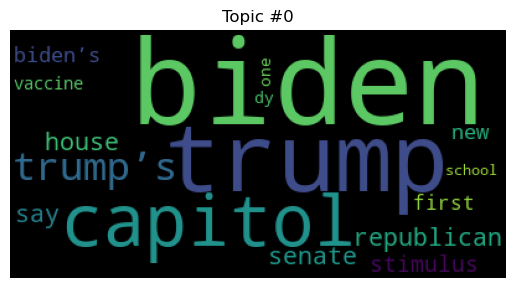

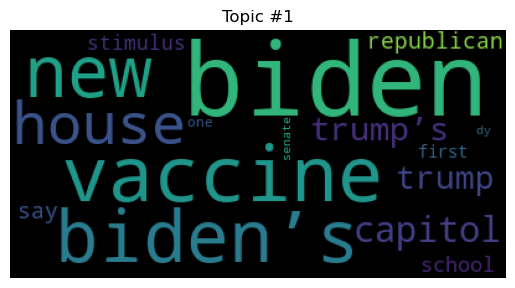

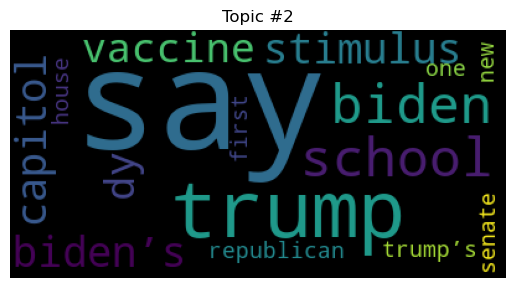

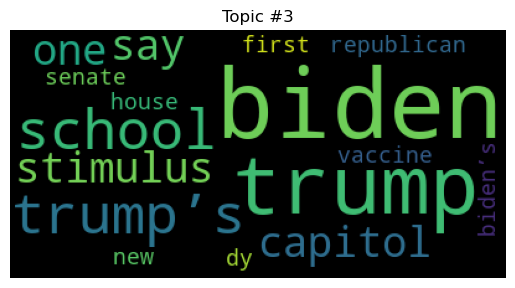

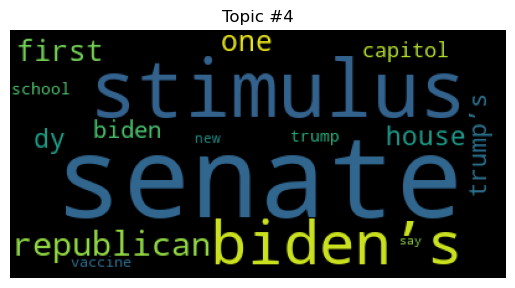

...

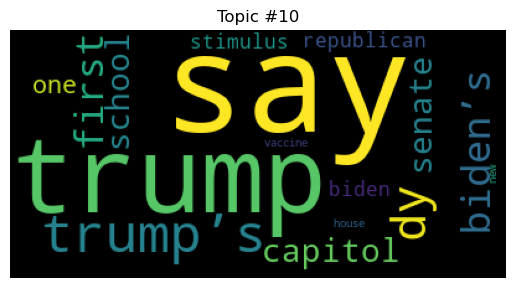

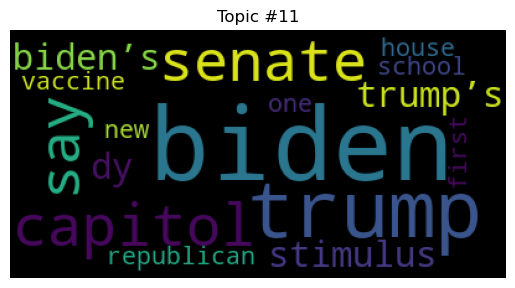

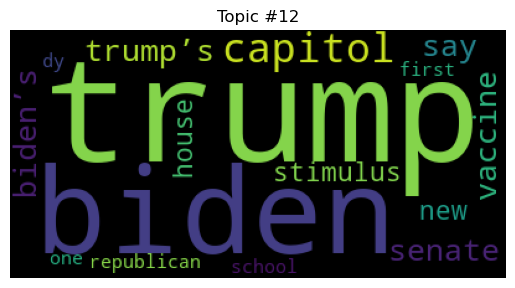

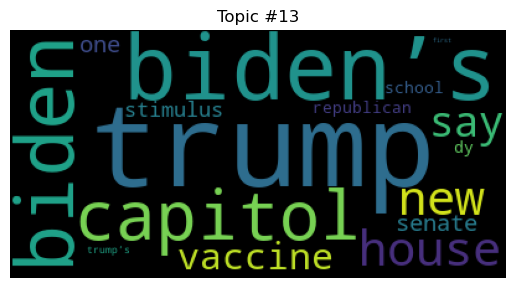

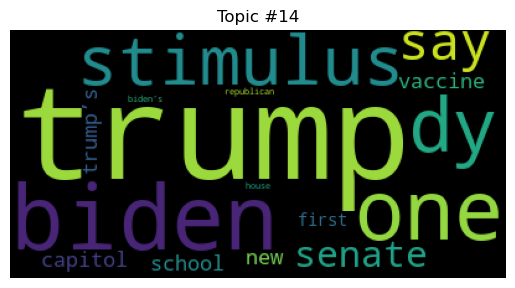

In [48]:
# Question 4
corpus = headlines['Headlines'].tolist()

# Preprocessing
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer
stop = set(stopwords.words('english'))
import string
punc = set(string.punctuation)
lemma = WordNetLemmatizer()
ps = PorterStemmer()

def clean(doc):
    html_tag_free=doc.replace('<br />',' ')
    stop_free = " ".join([i for i in html_tag_free.lower().split() if i not in stop])
    numb_free = "".join([i for i in stop_free if not i.isdigit()])
    punc_free = "".join(ch for ch in numb_free if ch not in punc)
    normalized = " ".join(lemma.lemmatize(word) for word in punc_free.split())
    stop_free = " ".join([i for i in normalized.lower().split() if i not in stop])
    one_letter_free = " ".join( [w for w in stop_free.split() if len(w)>1] )
    return one_letter_free
doc_clean = [clean(doc).split() for doc in corpus]
doc_clean_no_split = [clean(doc) for doc in corpus]

# Collocation
import gensim
bigram = gensim.models.Phrases(doc_clean, min_count=20, threshold=20)
bigram_model = gensim.models.phrases.Phraser(bigram)
norm_corpus_bigrams = [bigram_model[doc] for doc in doc_clean]

dictionary = gensim.corpora.Dictionary(norm_corpus_bigrams)
dictionary.filter_extremes(no_below = 20, no_above = 0.90)

# Bag of words
bow_corpus = [dictionary.doc2bow(text) for text in doc_clean]

# LDA Model
lda_model = gensim.models.LdaModel(corpus = bow_corpus, id2word = dictionary, random_state = 0, num_topics = 15)

# Wordclouds
import matplotlib.pyplot as plt
from wordcloud import WordCloud
for t in range(lda_model.num_topics):
    plt.figure()
    plt.imshow(WordCloud().fit_words(dict(lda_model.show_topic(t, 200))))
    plt.axis("off")
    plt.title("Topic #" + str(t))
    plt.show()

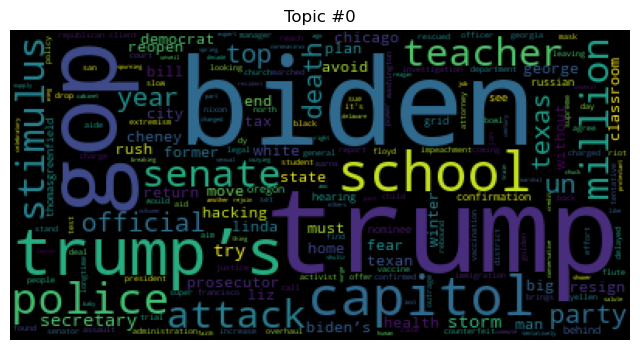

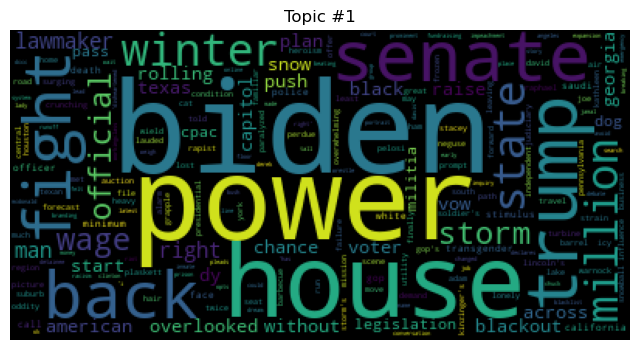

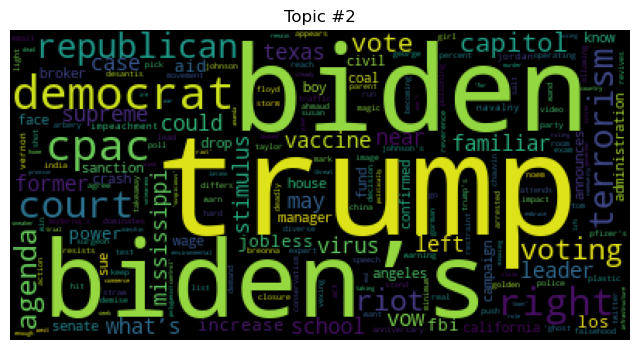

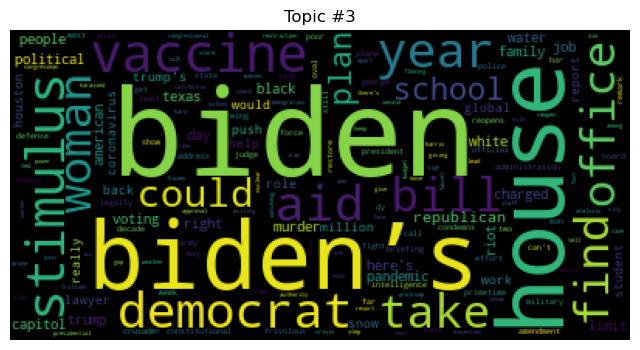

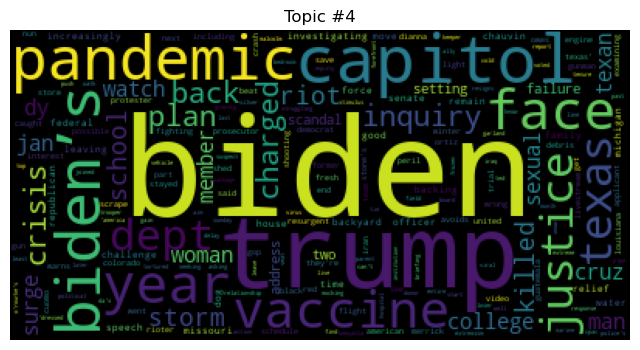

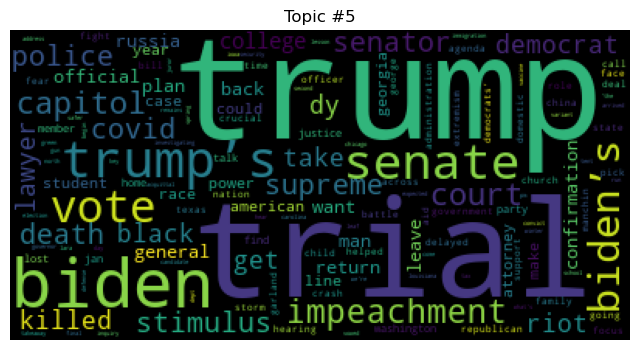

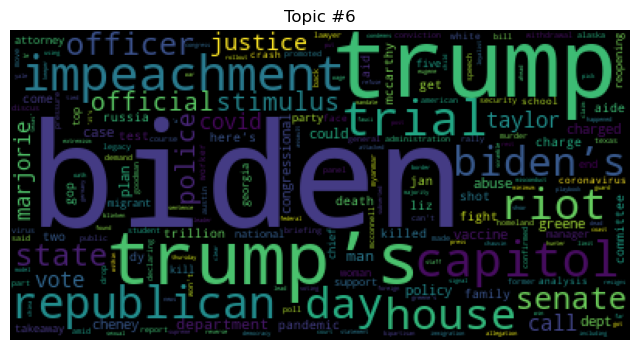

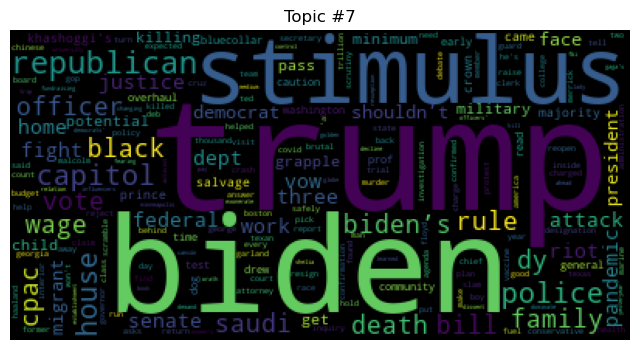

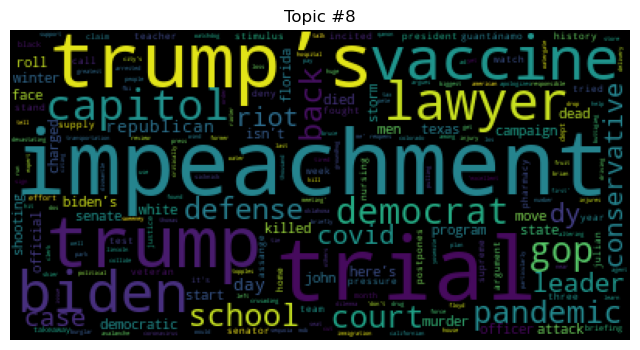

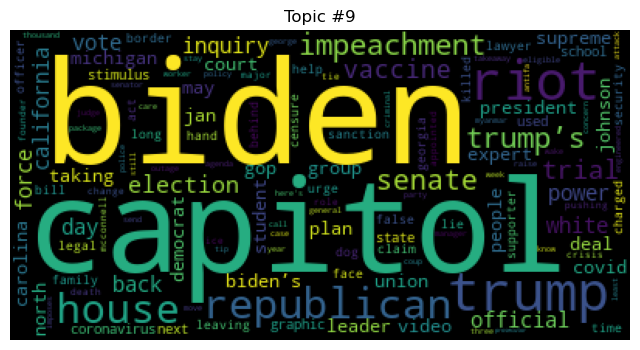

In [51]:
# Question 4 continued

# Improving the LDA algorithm
stop = stop.union(set(['one','new','say','first']))

def clean(doc):
    html_tag_free=doc.replace('<br />',' ')
    stop_free = " ".join([i for i in html_tag_free.lower().split() if i not in stop])
    numb_free = ''.join([i for i in stop_free if not i.isdigit()])
    punc_free = ''.join(ch for ch in numb_free if ch not in punc)
    normalized = " ".join(lemma.lemmatize(word) for word in punc_free.split())
    stop_free = " ".join([i for i in normalized.lower().split() if i not in stop])
    one_letter_free = ' '.join( [w for w in stop_free.split() if len(w)>1] )
    return one_letter_free
doc_clean = [clean(doc).split() for doc in corpus]
doc_clean_no_split = [clean(doc) for doc in corpus]
bigram=gensim.models.Phrases(doc_clean, min_count=20, threshold=20)
bigram_model=gensim.models.phrases.Phraser(bigram)
norm_corpus_bigrams=[bigram_model[doc] for doc in doc_clean]
dictionary= gensim.corpora.Dictionary(norm_corpus_bigrams)
bow_corpus=[dictionary.doc2bow(text) for text in doc_clean]

lda_model = gensim.models.LdaModel(corpus = bow_corpus, id2word=dictionary, random_state = 0, iterations=1000, 
                                   num_topics=10, passes=20)

for t in range(lda_model.num_topics):
    plt.figure(figsize = (8, 8))
    plt.imshow(WordCloud().fit_words(dict(lda_model.show_topic(t, 200))))
    plt.axis("off")
    plt.title("Topic #" + str(t))
    plt.show()

In [59]:
# Question 4 continued

# Find the optimal number of topics
ldadict={}
cvlist=[]
for k in range(10,101,5):
    ldadict[k] = gensim.models.LdaModel(corpus=bow_corpus, id2word=dictionary, 
                                        random_state = 0, num_topics = k)
    cv_eval=gensim.models.CoherenceModel(model = ldadict[k], corpus = bow_corpus, 
                                         texts = norm_corpus_bigrams, dictionary = dictionary, coherence='c_v')
    cvlist=list(cvlist+[cv_eval.get_coherence()])

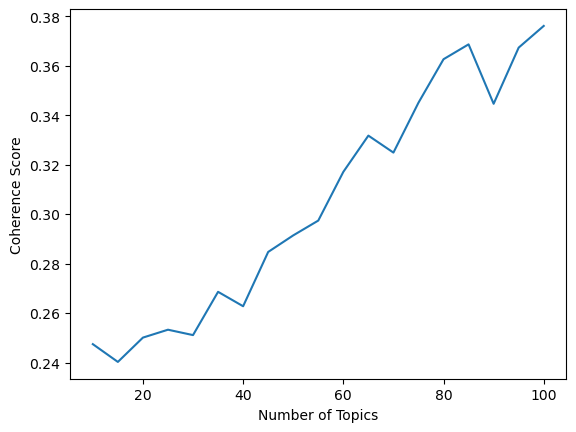

In [61]:
# Question 4 continued

x_ax = range(10,101,5)
y_ax = cvlist
plt.figure()
plt.plot(x_ax, y_ax)
xl=plt.xlabel('Number of Topics')
yp=plt.ylabel('Coherence Score')
plt.show()

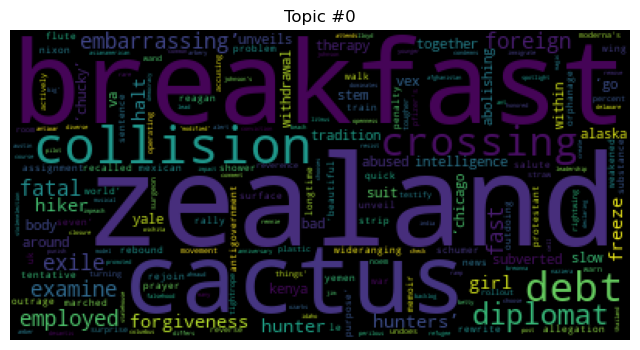

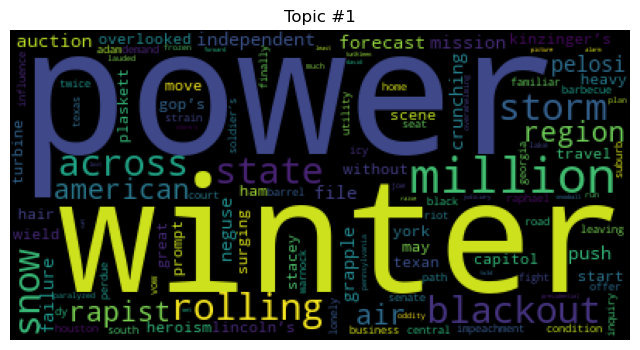

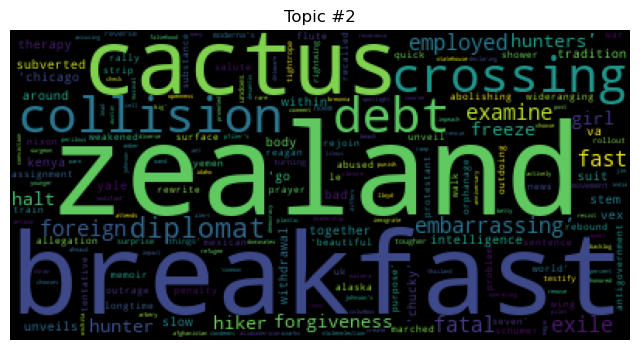

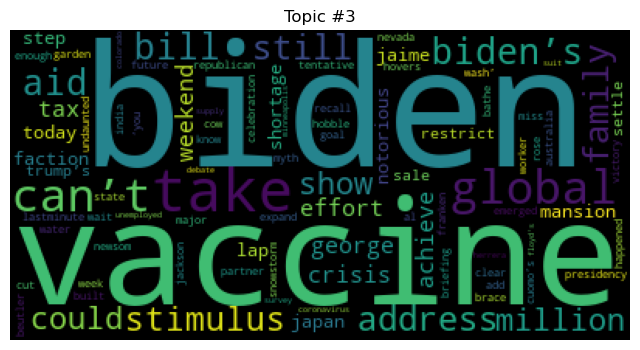

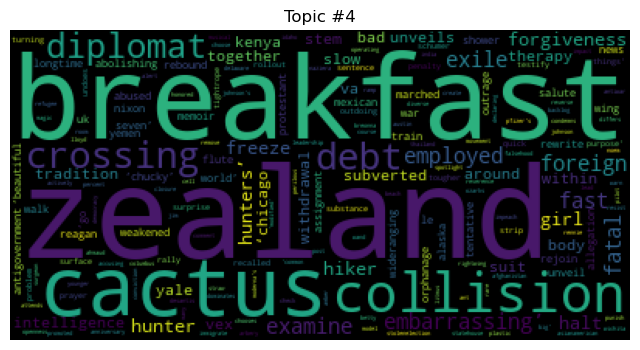

...

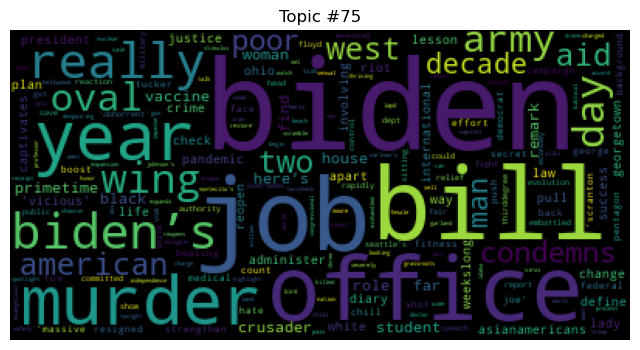

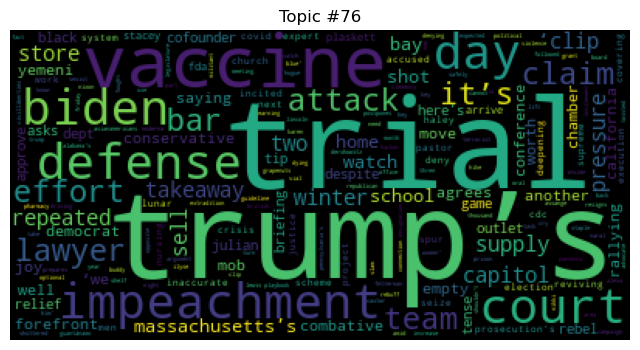

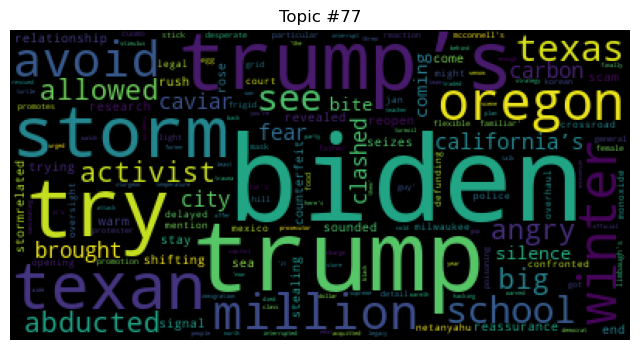

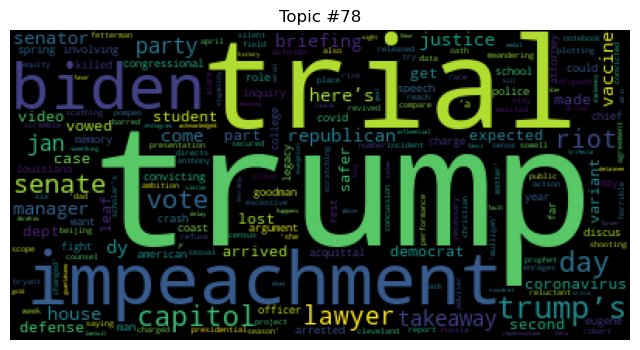

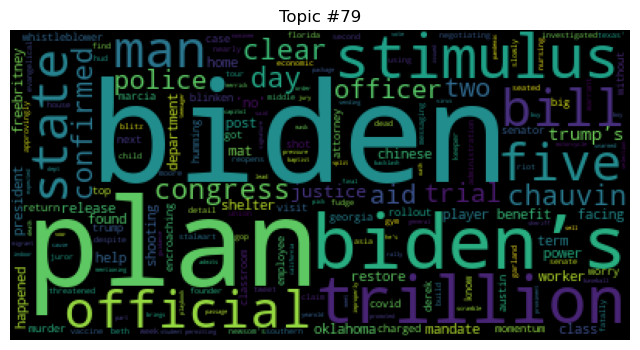

In [62]:
# Question 4 continued

lda_model = gensim.models.LdaModel(corpus = bow_corpus, id2word=dictionary, random_state = 0, iterations=1000, 
                                   num_topics=80, passes=20)

for t in range(lda_model.num_topics):
    plt.figure(figsize = (8, 8))
    plt.imshow(WordCloud().fit_words(dict(lda_model.show_topic(t, 200))))
    plt.axis("off")
    plt.title("Topic #" + str(t))
    plt.show()

In [ ]:
# Question 6
eco_vocab = [“uncertainty”, “uncertain”, “economic”, “economy”, “Congress”, “deficit”, 
             “Federal Reserve”, “legislation”, “regulation”, or “White House”, 
             “uncertainties”, “regulatory”, “the Fed”]
# For this question I would add a 'count' column to the original headlines dataframe signifying the number of articles that day.
# Then, I would interate over each row in the dataframe, each time taking the headline and iterating over each word to check if
# it is in eco_vocab, if at least 1 of the words in eco_vocab is in the headline, then it is counted for the uncertainty index.
# The sum of these counts can then be divided by the 'count' column to calculate the fraction of articles related to economic 
# policy uncertainty over the total number of articles that day

In [78]:
# Question 8
import re
sp500 = pd.read_csv("SP500.csv")
sp500['Adj Close**'] = sp500['Adj Close**'].replace(',','', regex=True).astype('float')
sp500 = sp500.iloc[::-1]
sp500['return'] = sp500['Adj Close**'].pct_change()
sp500

,Date,Open,High,Low,Close*,Adj Close**,Volume,return
47,4-Jan-21,"3,764.61","3,769.99","3,662.71","3,700.65",3700.65,"5,006,680,000",NaN
46,5-Jan-21,"3,698.02","3,737.83","3,695.07","3,726.86",3726.86,"4,582,620,000",0.007083
45,6-Jan-21,"3,712.20","3,783.04","3,705.34","3,748.14",3748.14,"6,049,970,000",0.005710
44,7-Jan-21,"3,764.71","3,811.55","3,764.71","3,803.79",3803.79,"5,080,870,000",0.014847
43,8-Jan-21,"3,815.05","3,826.69","3,783.60","3,824.68",3824.68,"4,764,180,000",0.005492
42,11-Jan-21,"3,803.14","3,817.86","3,789.02","3,799.61",3799.61,"4,450,500,000",-0.006555
41,12-Jan-21,"3,801.62","3,810.78","3,776.51","3,801.19",3801.19,"4,977,210,000",0.000416
40,13-Jan-21,"3,802.23","3,820.96","3,791.50","3,809.84",3809.84,"4,590,420,000",0.002276
39,14-Jan-21,"3,814.98","3,823.60","3,792.86","3,795.54",3795.54,"5,180,140,000",-0.003753
38,15-Jan-21,"3,788.73","3,788.73","3,749.62","3,768.25",3768.25,"5,353,060,000",-0.007190


In [ ]:
# Question 9
# Can plot 3 different plots using plt, each plotting 2 variables against each other:
# (covid index vs economic index), (covid index vs SP500 returns), (SP500 vs economic index)
# Given the plots, can comment on the correlation or lack of one between each variable

In [ ]:
# Question 10
# Begin by subsetting the original dataset into one with only headlines that contain at least one word in the 
# covid-related dictionary. This can be done similarly as in question 6 by iterating over each row and checking for words in dict